In [1]:
%matplotlib inline
import numpy as np
from scipy import misc
import matplotlib.pyplot as plt
import imageio

# SATELITE

In [2]:
from skimage import data

# Lee una imagen
photo_data = imageio.imread('C:/Users/Tole 01/Desktop/Micromaster_Data_Science/numpy_satellite/wifire/sd-3layers.jpg')

type(photo_data)

imageio.core.util.Array

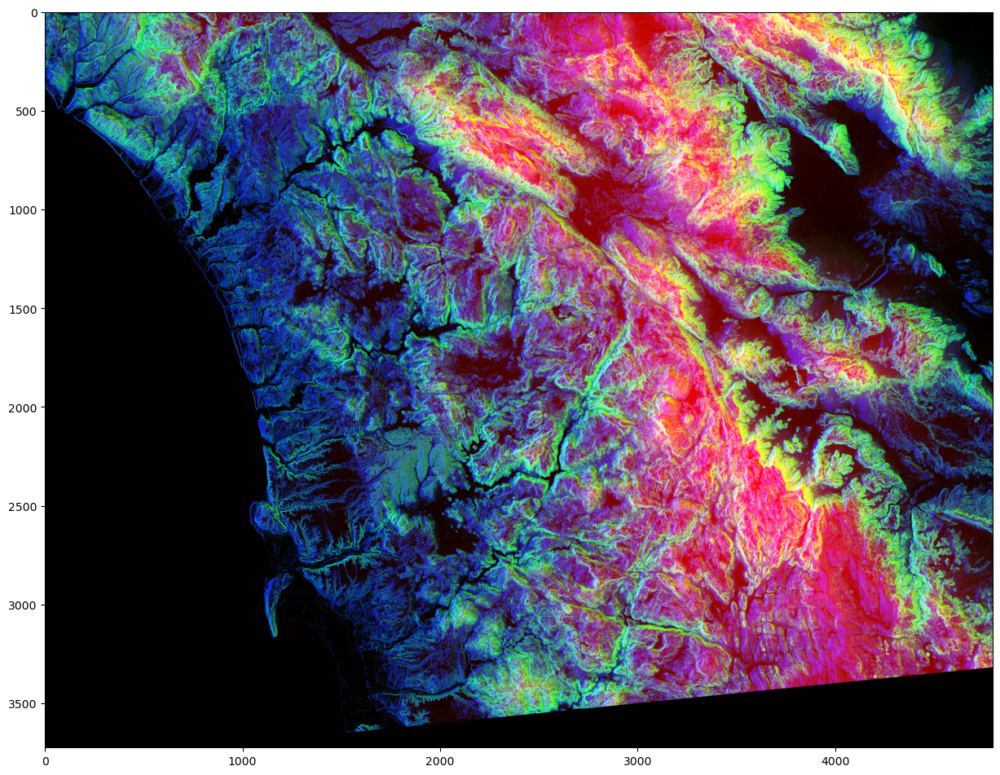

In [3]:
# Damos size a la grafica y mostramos la imagen
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

In [4]:
print(f'''El total de datos en el arreglo es de {photo_data.size} 
Las dimensiones del arreglo son {photo_data.shape}''')

El total de datos en el arreglo es de 53606475 
Las dimensiones del arreglo son (3725, 4797, 3)


En donde los primeros numeros significan el largo (3725) y el ancho (4797) de la matriz. Por otro lado, el 3 significa que la matriz tiene 3 capas de acuerdo con los colores RGB.

ROJO indica ALTITUD

AZUL indica ASPECTO

VERDE indica PENDIENTE

Entre mas grande sea el numero, la altitud, el aspecto y la pendientes seran mayor

In [5]:
# Este es el arreglo
print(photo_data)

[[[  0  22  35]
  [  0  11  57]
  [ 19  32 128]
  ...
  [ 19  21  98]
  [  0   6  28]
  [  0  19   0]]

 [[ 30  64 109]
  [ 29  46 128]
  [ 25  33 157]
  ...
  [  1   5  50]
  [  0   5  34]
  [  0   4  28]]

 [[ 23  57 155]
  [ 16  35 174]
  [ 15  24 189]
  ...
  [  0   5   9]
  [  0   5  34]
  [  0   2  69]]

 ...

 [[  2   0   1]
  [  2   0   1]
  [  2   0   1]
  ...
  [  2   0   1]
  [  2   0   1]
  [  2   0   1]]

 [[  2   0   1]
  [  2   0   1]
  [  2   0   1]
  ...
  [  2   0   1]
  [  2   0   1]
  [  2   0   1]]

 [[  2   0   1]
  [  2   0   1]
  [  2   0   1]
  ...
  [  2   0   1]
  [  2   0   1]
  [  2   0   1]]]


In [6]:
# Dato minimo, maximo y promedio
# La intensidad del color no puede salir de este rango
photo_data.min(), photo_data.max(), photo_data.mean()

(0, 255, 75.8299354508947)

### Seleccionar rango de datos

In [7]:
# Datos desde la fila 150, columna 250
photo_data[150,250]

Array([ 17,  35, 255], dtype=uint8)

In [8]:
# Datos desde la fila 150, columna 250, valor verde
photo_data[150,250,1]

35

### Cambiar colores en un arreglo

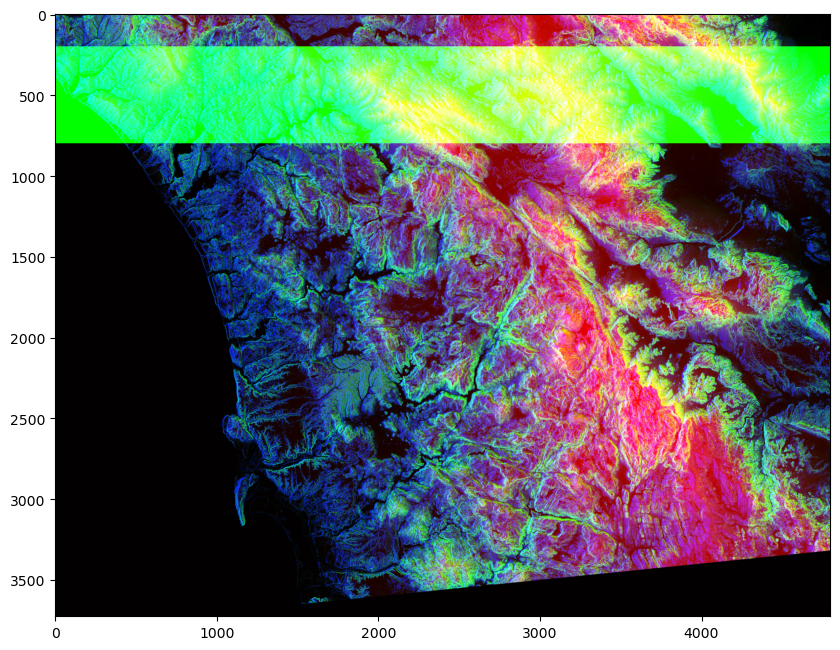

In [9]:
# Llevamos el verde a su valor maximo
photo_data_copy = photo_data.copy()
photo_data_copy[200:800, :,1] = 255
plt.figure(figsize=(10,10))
plt.imshow(photo_data_copy)

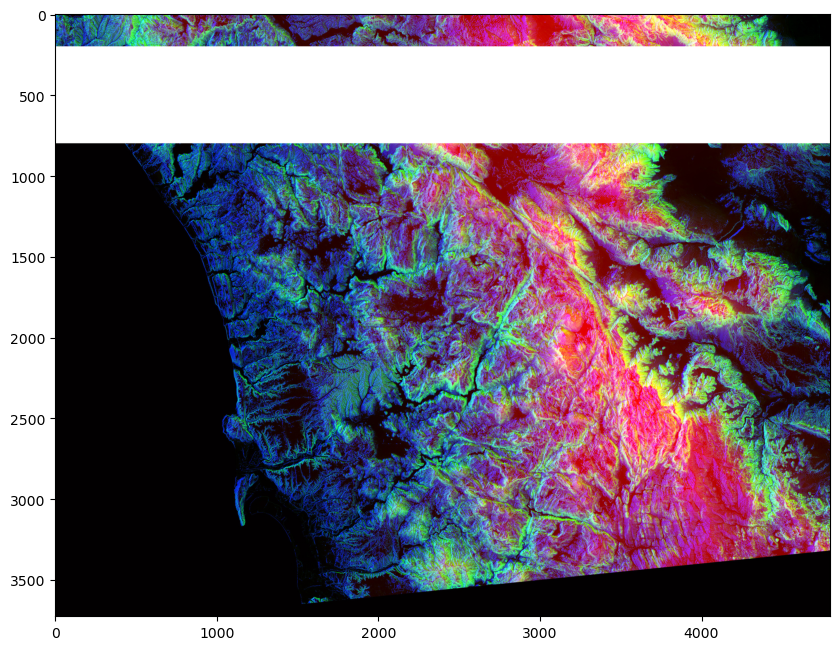

In [10]:
# Todo el RGB esta al maximo, por eso es blanco
photo_data_copy[200:800, :] = 255
plt.figure(figsize=(10,10))
plt.imshow(photo_data_copy)

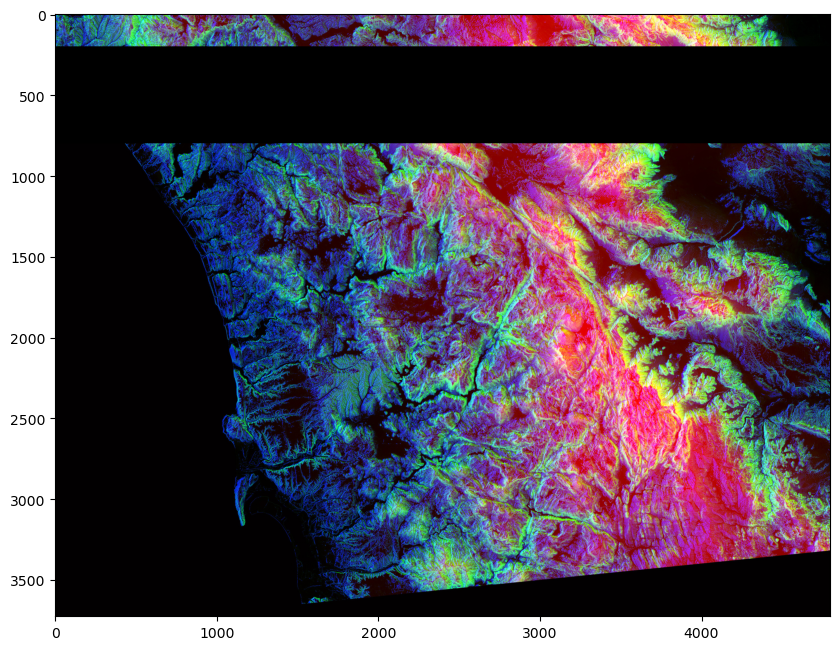

In [11]:
# Todo el RGB esta apagado, por eso es negro
photo_data_copy[200:800, :] = 0
plt.figure(figsize=(10,10))
plt.imshow(photo_data_copy)

### Filtrar pixeles

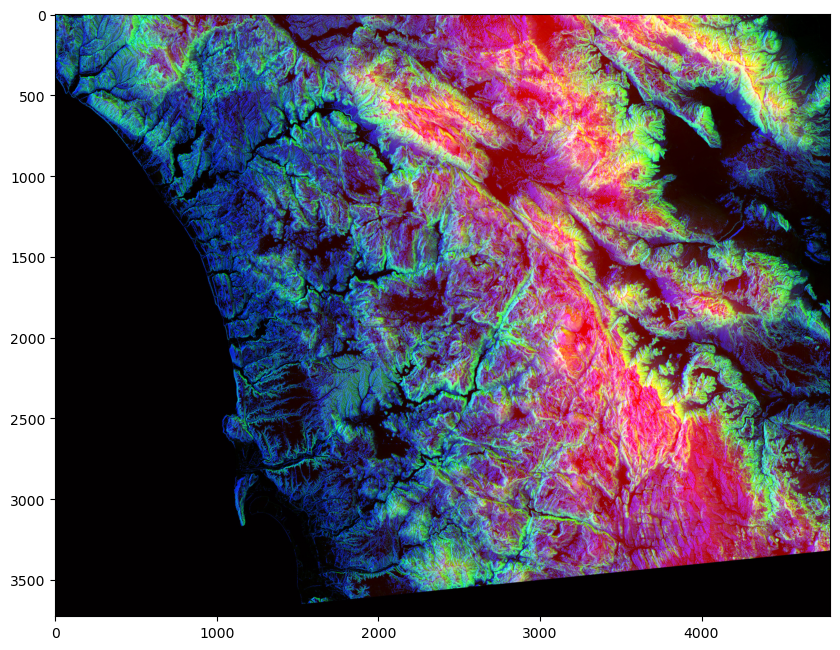

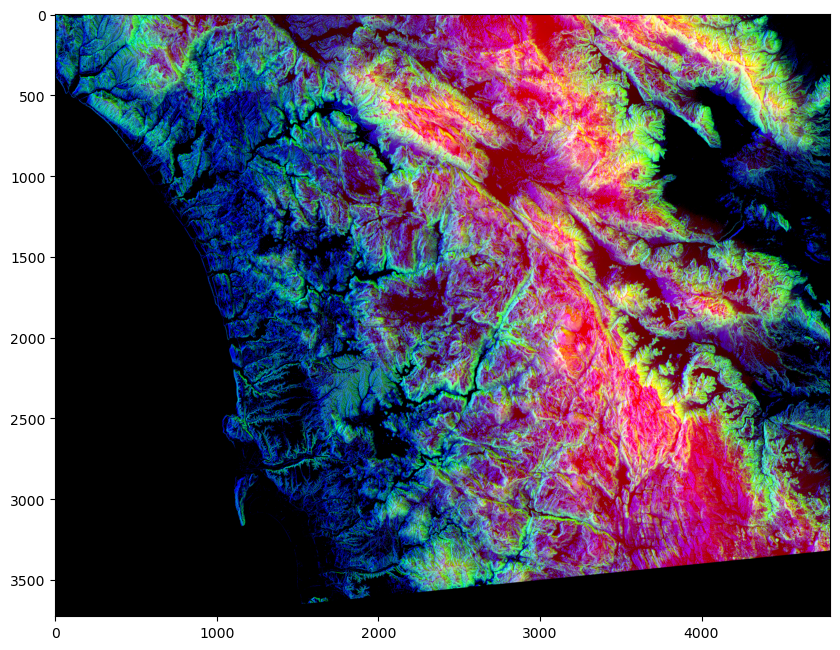

In [12]:
# Filtro chico
filtro_valores_chicos = photo_data < 50

# Imagen normal
plt.figure(figsize=(10,10))
plt.imshow(photo_data)

# Cambia los valores chicos por 0
photo_data[filtro_valores_chicos] = 0
plt.figure(figsize=(10,10))
plt.imshow(photo_data)

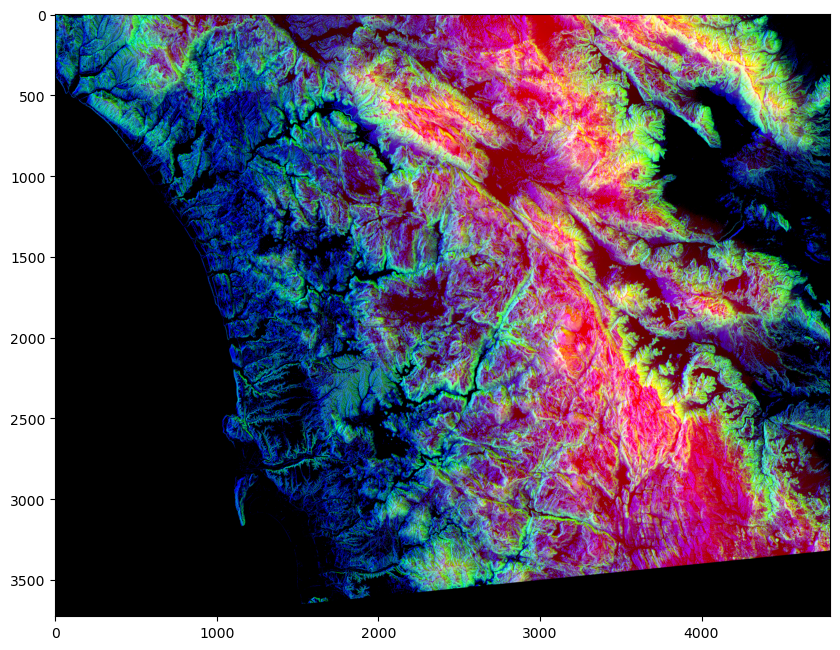

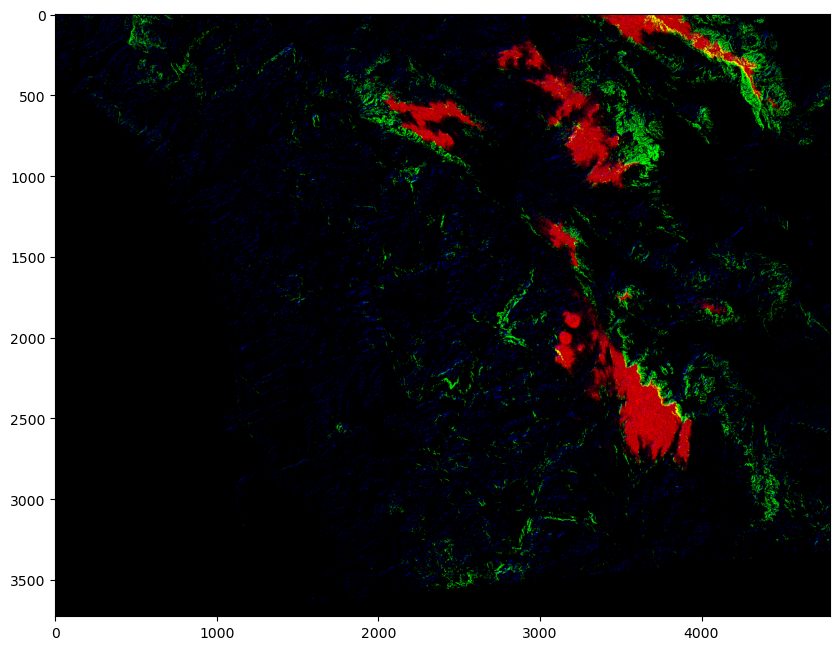

In [13]:
# Filtro chico
filtro_valores_chicos = photo_data < 249

# Imagen normal
plt.figure(figsize=(10,10))
plt.imshow(photo_data)

# Cambia los valores chicos por 0
photo_data[filtro_valores_chicos] = 0
plt.figure(figsize=(10,10))
plt.imshow(photo_data)

### Mas operaciones

In [14]:
photo_data = imageio.imread('C:/Users/Tole 01/Desktop/Micromaster_Data_Science/numpy_satellite/wifire/sd-3layers.jpg')

# Creamos un arreglo cuadrado de datos con arange. Arange recibe un numero y crea una lista con todos los numeros previos.
rows_range = np.arange(len(photo_data))
cols_range = rows_range
print(type(rows_range))
rows_range

<class 'numpy.ndarray'>


array([   0,    1,    2, ..., 3722, 3723, 3724])

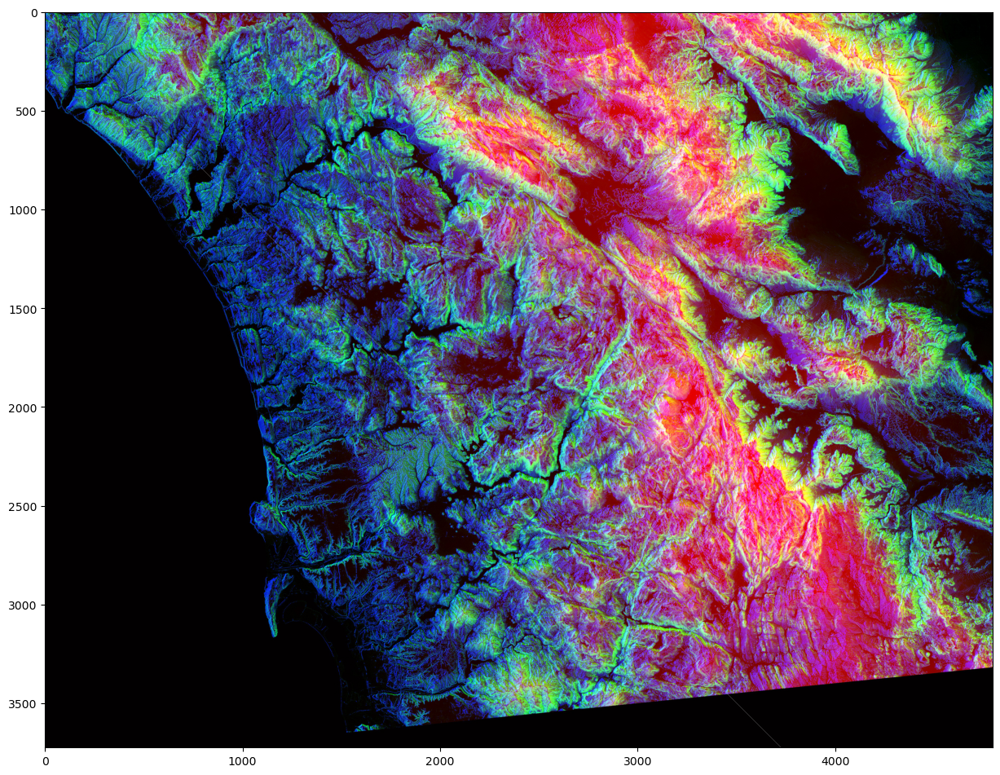

In [15]:
# Los igualamos al maximo
photo_data[rows_range, rows_range] = 255

# Traza una diagonal blanca en la imagen
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

# IMAGEN TRUE FALSE

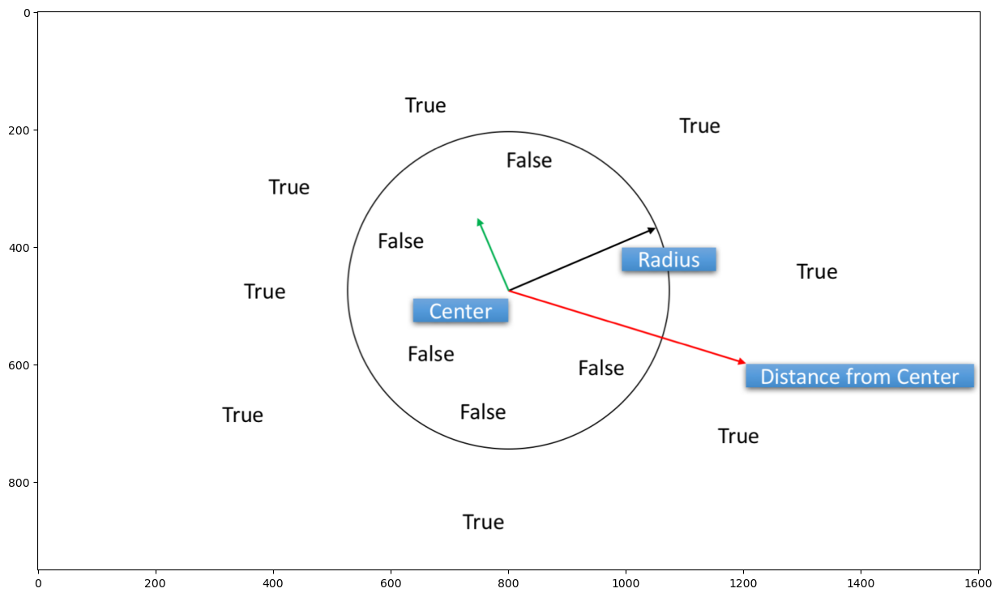

In [20]:
photo_data_2 = imageio.imread('C:/Users/Tole 01/Desktop/Micromaster_Data_Science/numpy_satellite/1494532821.png')
plt.figure(figsize=(15,15))
plt.imshow(photo_data_2)

In [32]:
# Asignamos 3 variables a cada dato dentro de shape
total_rows, total_cols, total_layers = photo_data.shape
print("photo_data = ", photo_data.shape)

# ogrid vectoriza la imagen para medir sus ejes y calcular su centro
X, Y = np.ogrid[:total_rows, :total_cols]
print("X = ", X.shape, " and Y = ", Y.shape)

photo_data =  (3725, 4797, 3)
X =  (3725, 1)  and Y =  (1, 4797)


In [33]:
# centro del array de la imagen
center_row, center_col = total_rows/2 , total_cols/2
print(f'''El centro de center_row es {center_row}
y el centro de center_col es {center_col}
''')

# Se le resta cada posicion al centro de la imagen y se eleva al cuadrado
dist_from_center = (X - center_row)**2 + (Y - center_col)**2
print(f'''Esta es la suma de los catetos al cuadrado {dist_from_center}
''')

# Definimos el radio del circulo al cuadrado, para comparar la distancia al cuadrado
radius = (total_rows / 2)**2
print(f'''Este es el radio al cuadrado {radius}
''')

# Filtro por las distancias que son mayores que el radio
circular_mask = (dist_from_center > radius)
print(f'''{circular_mask}
''')

# El area interna del circulo (1500:1700 renglones y 2000:2200 columnas) es falsa
print(dist_from_center < radius)

El centro de center_row es 1862.5
y el centro de center_col es 2398.5

Esta es la suma de los catetos al cuadrado [[9221708.5 9216912.5 9212118.5 ... 9207326.5 9212118.5 9216912.5]
 [9217984.5 9213188.5 9208394.5 ... 9203602.5 9208394.5 9213188.5]
 [9214262.5 9209466.5 9204672.5 ... 9199880.5 9204672.5 9209466.5]
 ...
 [9210542.5 9205746.5 9200952.5 ... 9196160.5 9200952.5 9205746.5]
 [9214262.5 9209466.5 9204672.5 ... 9199880.5 9204672.5 9209466.5]
 [9217984.5 9213188.5 9208394.5 ... 9203602.5 9208394.5 9213188.5]]

Este es el radio al cuadrado 3468906.25

[[ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 ...
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]]

[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False F

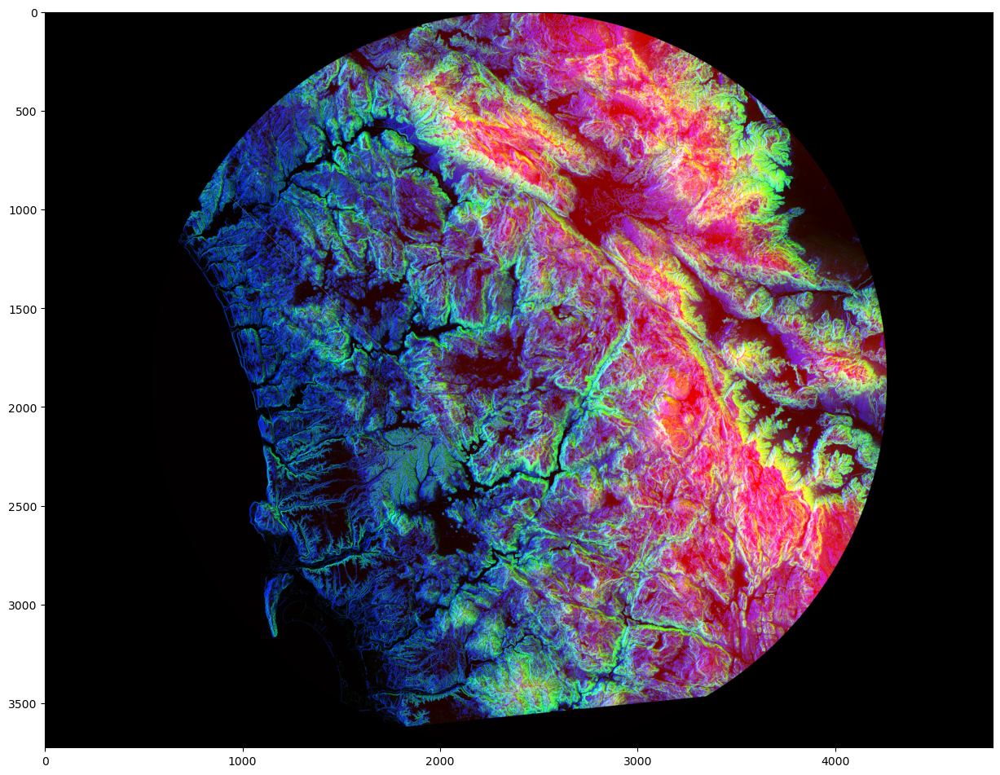

In [34]:
# Con esta funcion, borraremos la parte externa de la imagen con 0
photo_data[circular_mask] = 0
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

In [37]:
# Otro filtro puede ser una mdeia luna en la parte superior
# X es altura, por lo que se  seleccionaran los datos superiores al centro
half_upper = X < center_row

# Se unen ambos filtros a traves de la funcion logical_and
half_upper_mask = np.logical_and(half_upper, circular_mask)

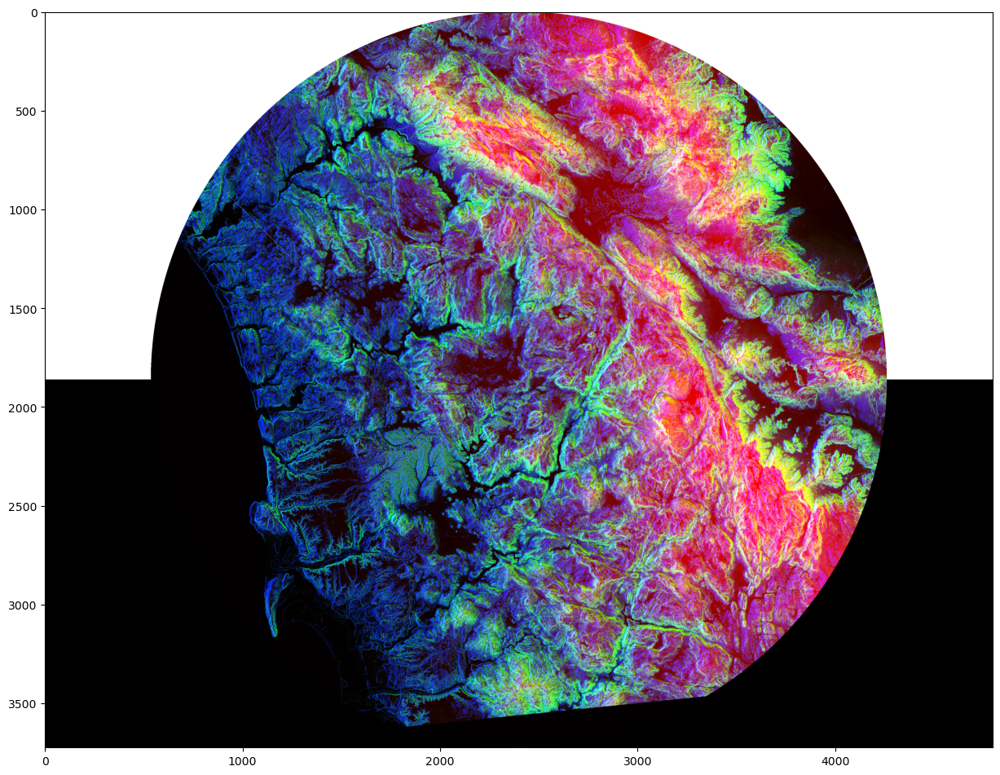

In [38]:
# Se aplican ambos filtros sobre la imagen y se genera lo siguiente
photo_data[half_upper_mask] = 255
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

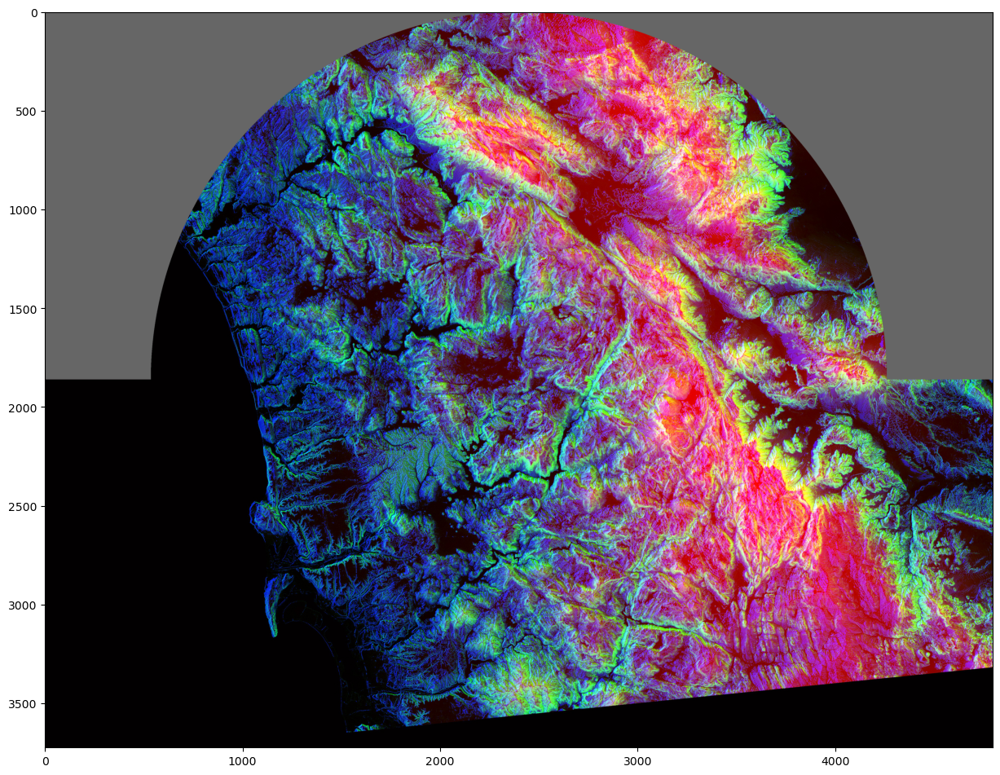

In [41]:
# Se aplican ambos filtros sobre la imagen y se genera lo siguiente
import random

photo_data = imageio.imread('C:/Users/Tole 01/Desktop/Micromaster_Data_Science/numpy_satellite/wifire/sd-3layers.jpg')
photo_data[half_upper_mask] = random.randint(100,255)
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

### Seccionar por colores

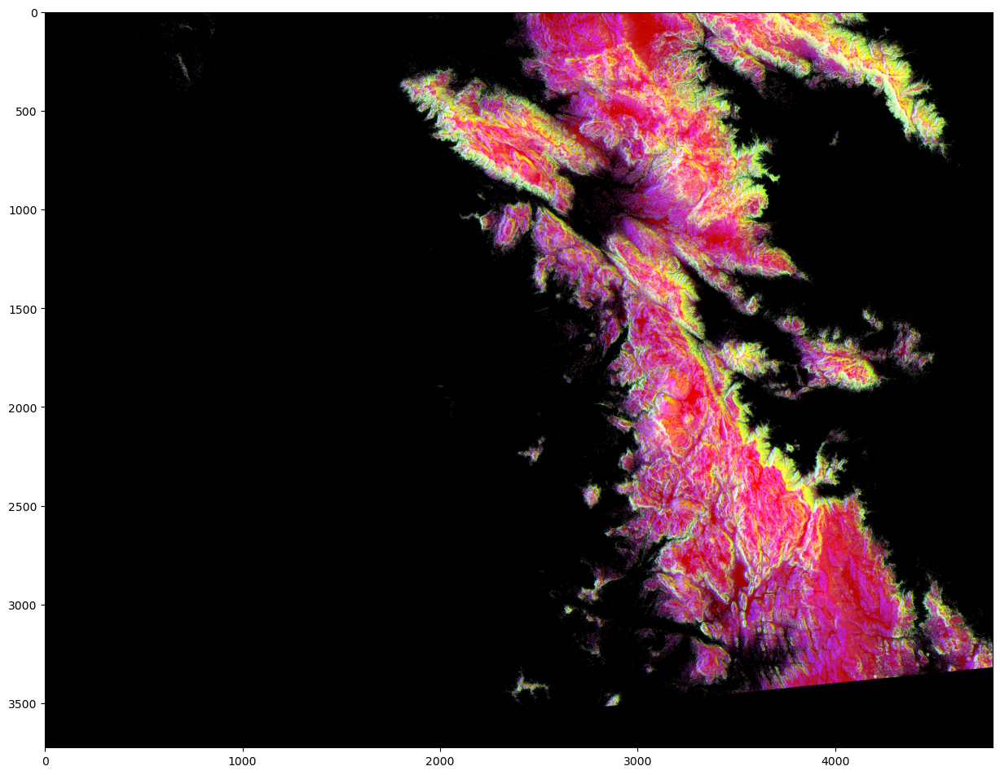

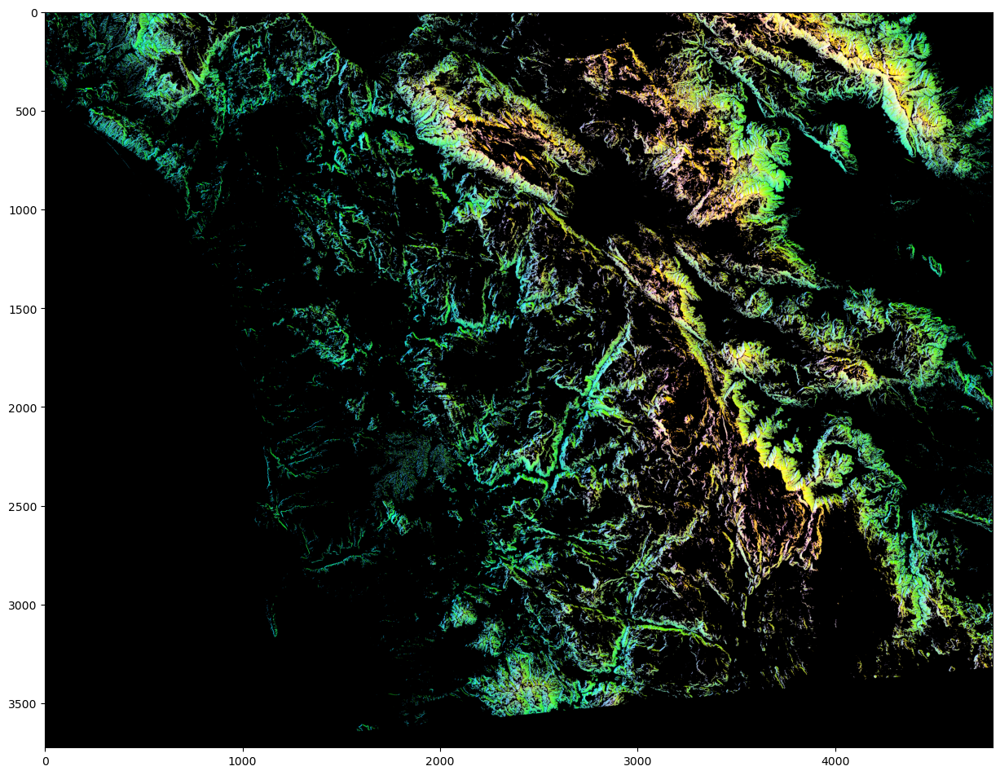

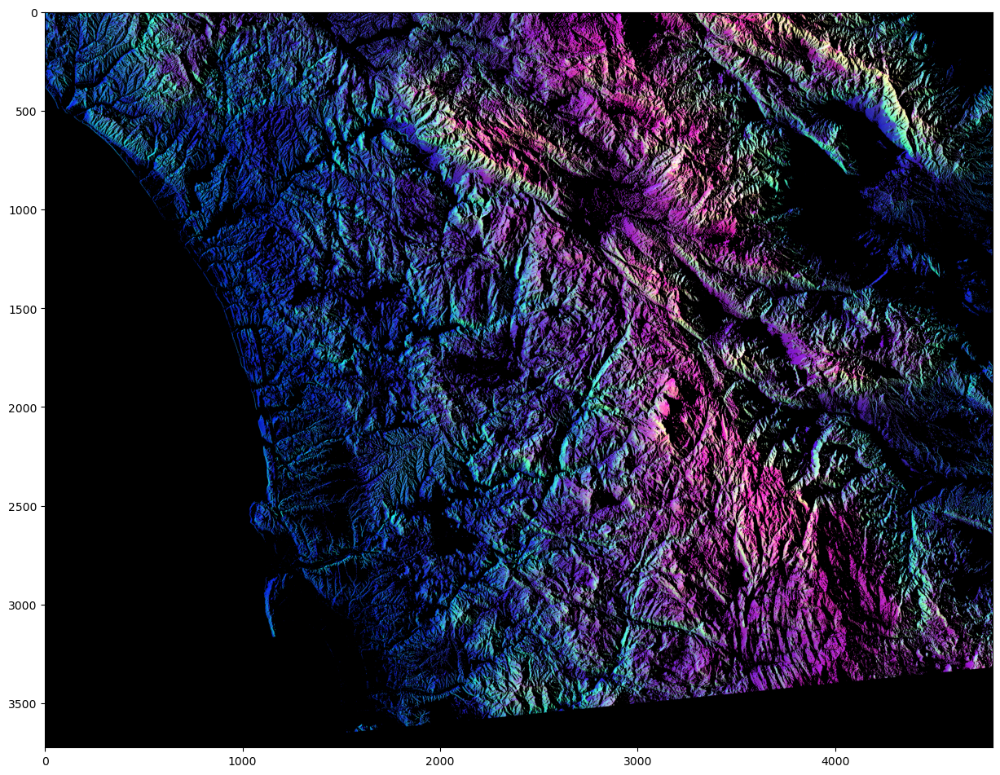

In [44]:
photo_data = imageio.imread('C:/Users/Tole 01/Desktop/Micromaster_Data_Science/numpy_satellite/wifire/sd-3layers.jpg')

# Recordar que son 3 capas. 0:rojo, 1:verde, 2:azul
filtro_rojo = photo_data[:,:,0] < 150 
filtro_verde = photo_data[:,:,1] < 150
filtro_azul = photo_data[:,:,2] < 150 

photo_data[filtro_rojo] = 0
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

photo_data = imageio.imread('C:/Users/Tole 01/Desktop/Micromaster_Data_Science/numpy_satellite/wifire/sd-3layers.jpg')
photo_data[filtro_verde] = 0
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

photo_data = imageio.imread('C:/Users/Tole 01/Desktop/Micromaster_Data_Science/numpy_satellite/wifire/sd-3layers.jpg')
photo_data[filtro_azul] = 0
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

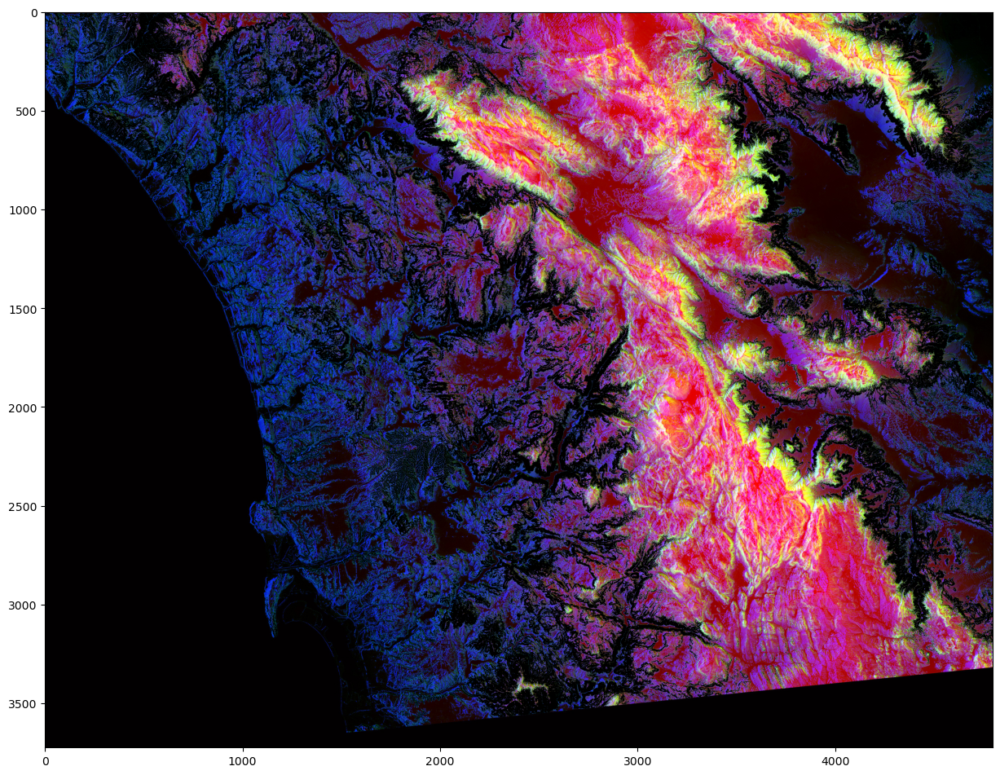

In [46]:
photo_data = imageio.imread('C:/Users/Tole 01/Desktop/Micromaster_Data_Science/numpy_satellite/wifire/sd-3layers.jpg')

# Recordar que son 3 capas. 0:rojo, 1:verde, 2:azul
filtro_rojo = photo_data[:,:,0] < 150 
filtro_verde = photo_data[:,:,1] > 100
filtro_azul = photo_data[:,:,2] < 100 

# Se juntan todos los filtros en uno solo
final_mask = np.logical_and(filtro_rojo,filtro_verde,filtro_azul)
photo_data[final_mask] = 0
plt.figure(figsize=(15,15))
plt.imshow(photo_data)